<a href="https://colab.research.google.com/github/FCardellino/DiploDatos-NoSupervizado/blob/main_entrega/TP_AprendizajeNoSupervisado.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Esta es la librería para generar el primer reporteJinja2
!pip install dataprep

In [ ]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns',100)
pd.set_option('display.max_rows',1000)
import itertools
import warnings
warnings.filterwarnings("ignore")
import io
from plotly.offline import init_notebook_mode, plot,iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization
import seaborn as sns

In [ ]:
from sklearn.cluster import KMeans,MeanShift
from sklearn import decomposition

In [ ]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import normalize
from sklearn.decomposition import PCA
from sklearn.neighbors import NearestNeighbors

In [ ]:
# Load the Drive helper and mount
from google.colab import drive

# This will prompt for authorization.
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#from dataprep.datasets import load_dataset   # Used to import / load dataset
from dataprep.eda import create_report   # Used to load Report formate
#import numpy as np     # Importing Python Library
#df = load_dataset("titanic")      # defining dataset

In [ ]:
!ls '/content/drive/MyDrive/Colab Notebooks/DiploDatos2022/ANS/players_22.csv'

'/content/drive/MyDrive/Colab Notebooks/DiploDatos2022/ANS/players_22.csv'


In [ ]:
df=pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DiploDatos2022/ANS/players_22.csv')

#1)Analisis exploratorio del dataset

A los fines de lograr una primer visualización del dataset previo a todo procesamiento, se genera el siguiente reporte

DataPrep Report
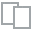
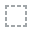
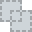
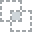
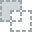
...
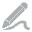
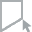
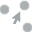
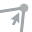
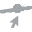

In [ ]:
#Generate Detailed EDA report with sigle line of code 
create_report(df)

Tal como se obseva en el overview del reporte, existe una gran cantidad de datos faltantes, por lo que en el siguiente punto se realizara un primer preprocesamiento del dataset para luego proceder a la evaluación visual de las variables numéricas

#2)Evaluación visual  e intuitiva de a dos variables numéricas por vez.

##Preparación de los datos:


Primero se verifica si existen datos nulos

In [ ]:
data=df
nans = data.isna().sum().sort_values(ascending=False)
print(nans[nans!=0]/data.shape[0])

nation_jersey_number         0.960549
nation_logo_url              0.960549
nation_position              0.960549
nation_team_id               0.960549
club_loaned_from             0.942721
player_tags                  0.925100
goalkeeping_speed            0.889183
player_traits                0.511513
dribbling                    0.110817
shooting                     0.110817
passing                      0.110817
physic                       0.110817
defending                    0.110817
pace                         0.110817
release_clause_eur           0.061126
club_joined                  0.060450
value_eur                    0.003846
club_contract_valid_until    0.003171
league_level                 0.003171
club_jersey_number           0.003171
club_position                0.003171
league_name                  0.003171
club_name                    0.003171
wage_eur                     0.003171
club_logo_url                0.003171
club_flag_url                0.003171
club_team_id

A continuación se obtienen aquellas columnas que tengan más del 50% de valores perdidos para luego quitarlas

In [ ]:
drop_vars = nans[list(nans/data.shape[0] > 0.5)].keys()
for var in drop_vars:
    print(var)
    data.drop(var,inplace=True,axis=1)

nation_jersey_number
nation_logo_url
nation_position
nation_team_id
club_loaned_from
player_tags
goalkeeping_speed
player_traits


Para los valores nulos/perdidos que aún se encuentren en el dataset, se proceder a imputarlos calculando la media de los datos existentes

In [ ]:
data.fillna(data.mean(numeric_only=True), inplace=True)

A los fines de hacer más claro el analisis posterior de los cluster se suma una nueva columna al dataset para agrupar a los jugadores en posiciones más genéricas que las que figuran en la columna "player_position". Esto en razón de que consideramos que la posición de los jugadores es un dato que puede influir en los clusters que se generen. La idea es corrorborar si esta asunción se verifica o no.

In [ ]:
forwards=['RF', 'ST', 'LW', 'LF', 'RS', 'LS', 'RM', 'LM','RW']
midfielders=['RCM','LCM','LDM','CAM','CDM','LAM','RDM','CM','RAM','CF']
defenders=['RCB','CB','LCB','LB','RB','RWB','LWB']
goalkeepers=['GK']

def pos2(position):
    position = position.split(',')[0]
    if position in forwards:
        return 'Forward'
    
    elif position in midfielders:
        return 'Midfielder'
    
    elif position in defenders:
        return 'Defender'
    
    elif position in goalkeepers:
        return 'GK'
    
    else:
        return 'nan'         

In [ ]:
data["position_group"]=data["player_positions"].apply(lambda x: pos2(x))

En las siguientes lineas separamos las columnas categoricas y las numéricas.

In [ ]:
#Identificamos las variables categoricas
categorical_variables = ['sofifa_id',
 'player_url',
 'short_name',
 'long_name',
 'player_positions',
 'dob',
 'club_team_id',
 'club_name',
 'league_name',
 'league_level',
 'club_position',
 'club_jersey_number',
 'club_joined',
 'club_contract_valid_until',
 'nationality_id',
 'nationality_name',
 'preferred_foot',
 'weak_foot',
 'skill_moves',
 'international_reputation',
 'work_rate',
 'body_type',
 'real_face',
 'ls',
 'st',
 'rs',
 'lw',
 'lf',
 'cf',
 'rf',
 'rw',
 'lam',
 'cam',
 'ram',
 'lm',
 'lcm',
 'cm',
 'rcm',
 'rm',
 'lwb',
 'ldm',
 'cdm',
 'rdm',
 'rwb',
 'lb',
 'lcb',
 'cb',
 'rcb',
 'rb',
 'gk',
 'player_face_url',
 'club_logo_url',
 'club_flag_url',
 'nation_flag_url',
 'position_group']

# Para valores del dataset que caen en las columnas que identificamos como categóricas, pasamos estos valores a objeto. En caso que 
# no sean categóricas, las pasamos a variables numéricas reales (float)
for val in data:
    if val in categorical_variables:
        data[val]=data[val].astype('object')
    else:
        pd.to_numeric(data[val], downcast="float")

In [ ]:
#Identificados las variables numéricas
df_numerical_columns = data.loc[:,data.dtypes != 'object']
df_numerical_columns.columns

Index(['overall', 'potential', 'value_eur', 'wage_eur', 'age', 'height_cm',
       'weight_kg', 'release_clause_eur', 'pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic', 'attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking_awareness',
       'defending_standing_tackle', 'defending_sliding_tackle',
       'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking',
      

## Evaluación visual e intuitiva de las variables

En las siguientes líneas de código procederemos a hacer una comparación entre las variables numéricas. A los fines de hacer un análisis más ordenado, optamos por ir comparandolas en forma agrupada en base a la keyword (indicativa del tipo de skill) que les antecede en el nombre:
* Attacking
* Skill
* Movement
* Power
* Mentality
* Defending
* Goalkeeping

NOTA: Por cada subgrupo se realizaron dos tipos de visualiazaciones. Primero una visualización sencilla y luego sumando a la variable position_group como leyenda para visualizar si existe o no un agrupamiento de los datos.

### Columnas sin keyword

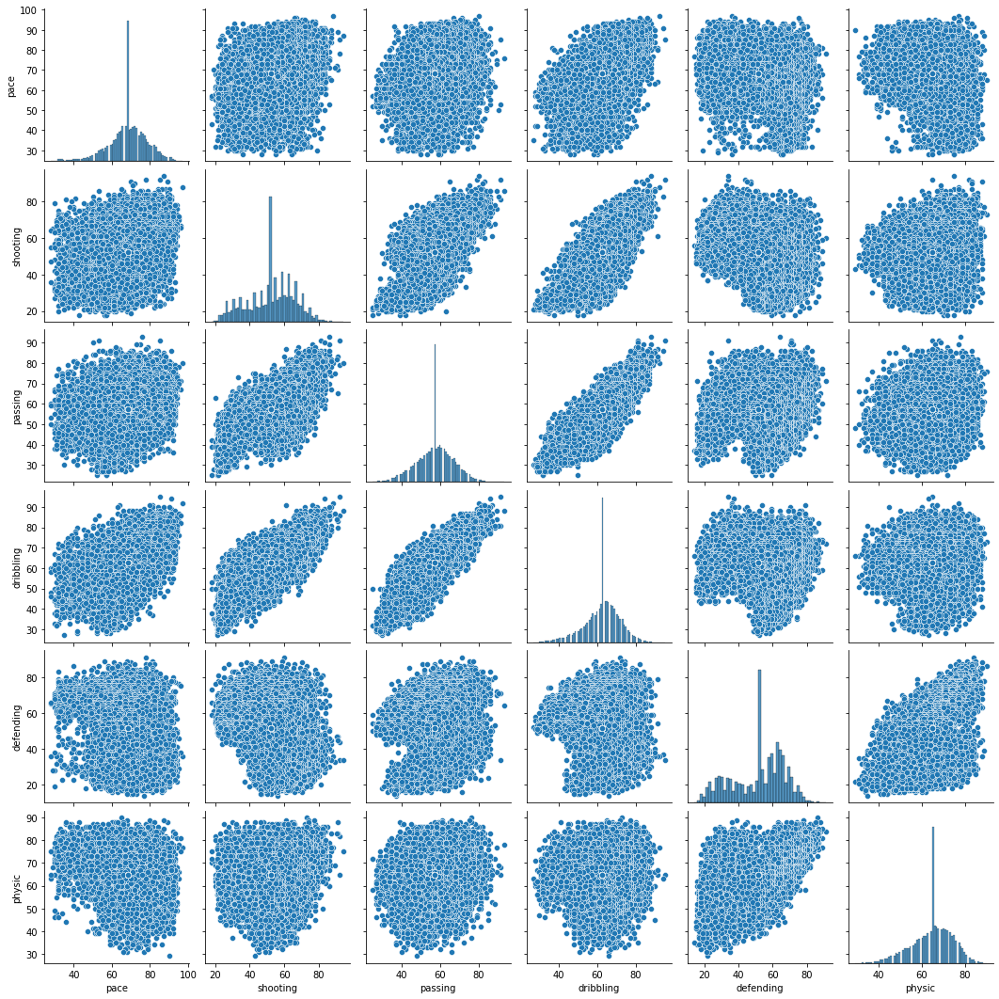

In [ ]:
#Columnas vinculadas a habilidades de maniobra
col = ['pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

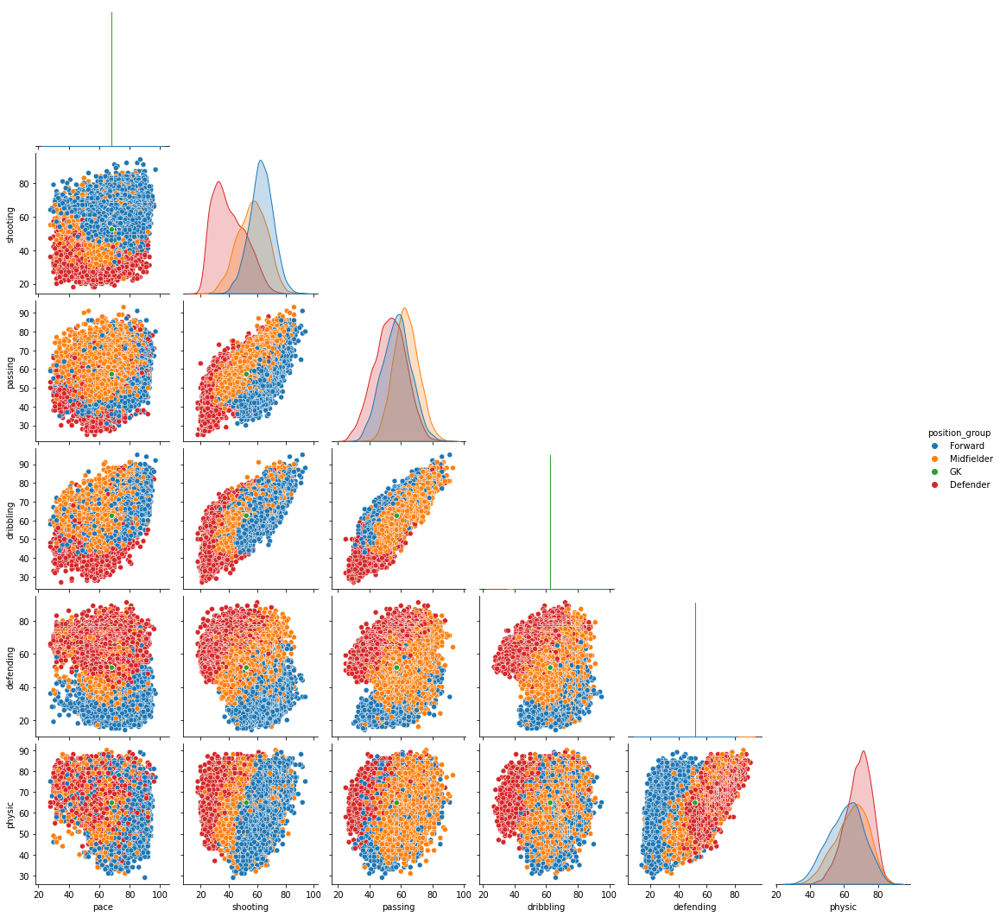

In [ ]:
position_group = data['position_group']

col = ['pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic']
dat = df_numerical_columns[col]
dat = dat.join(position_group)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_1.jpg', bbox_inches = 'tight')

### Attacking

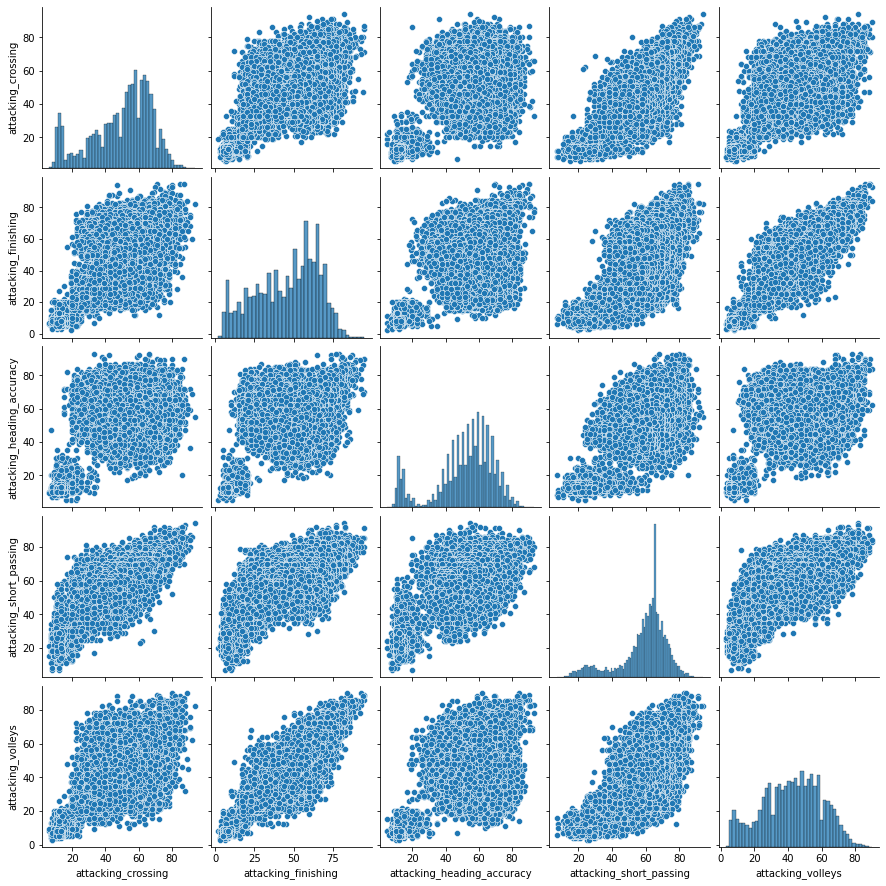

In [ ]:
col = ['attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

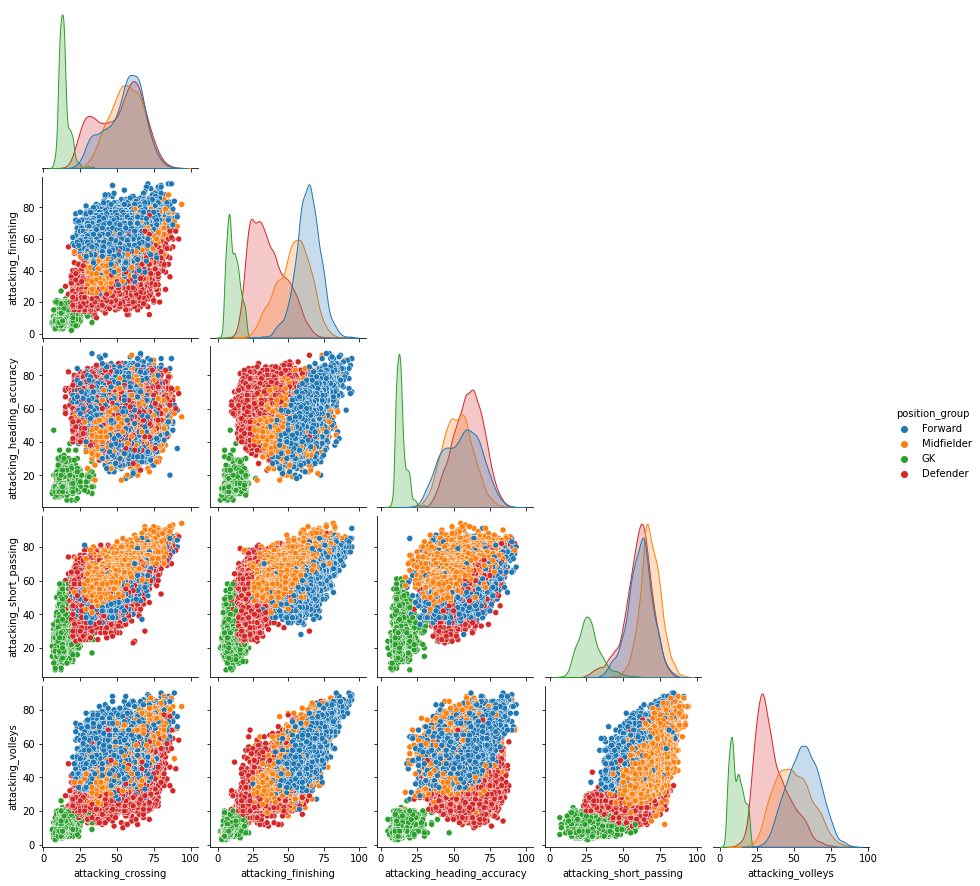

In [ ]:
col = ['attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys']
dat = df_numerical_columns[col]
dat = dat.join(position_group)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_2.jpg', bbox_inches = 'tight')

### Skill

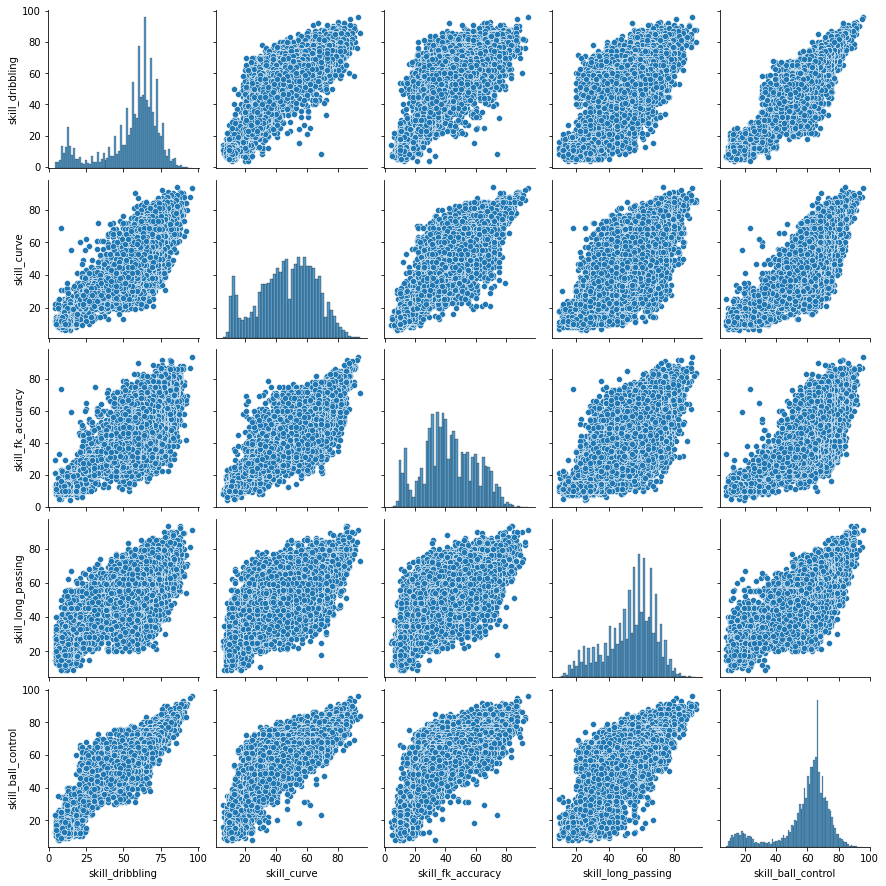

In [ ]:
col = ['skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

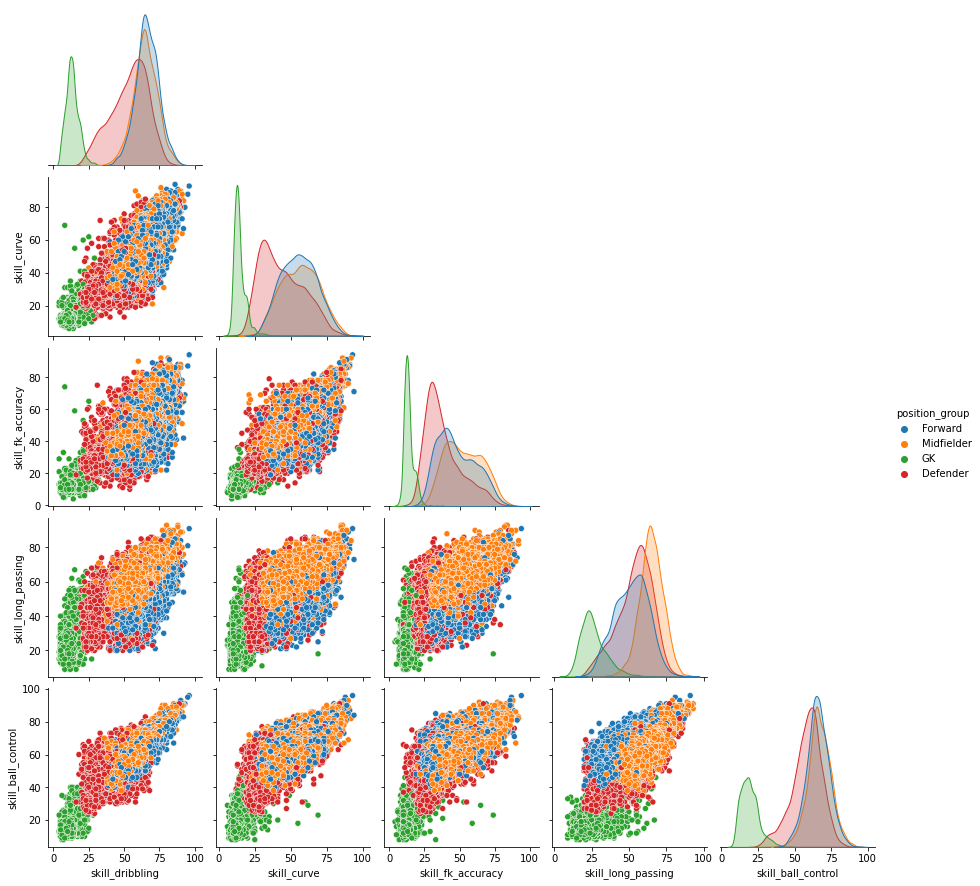

In [ ]:
col = ['skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control']
dat = df_numerical_columns[col]
dat = dat.join(position_group)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_3.jpg', bbox_inches = 'tight')

### Movement

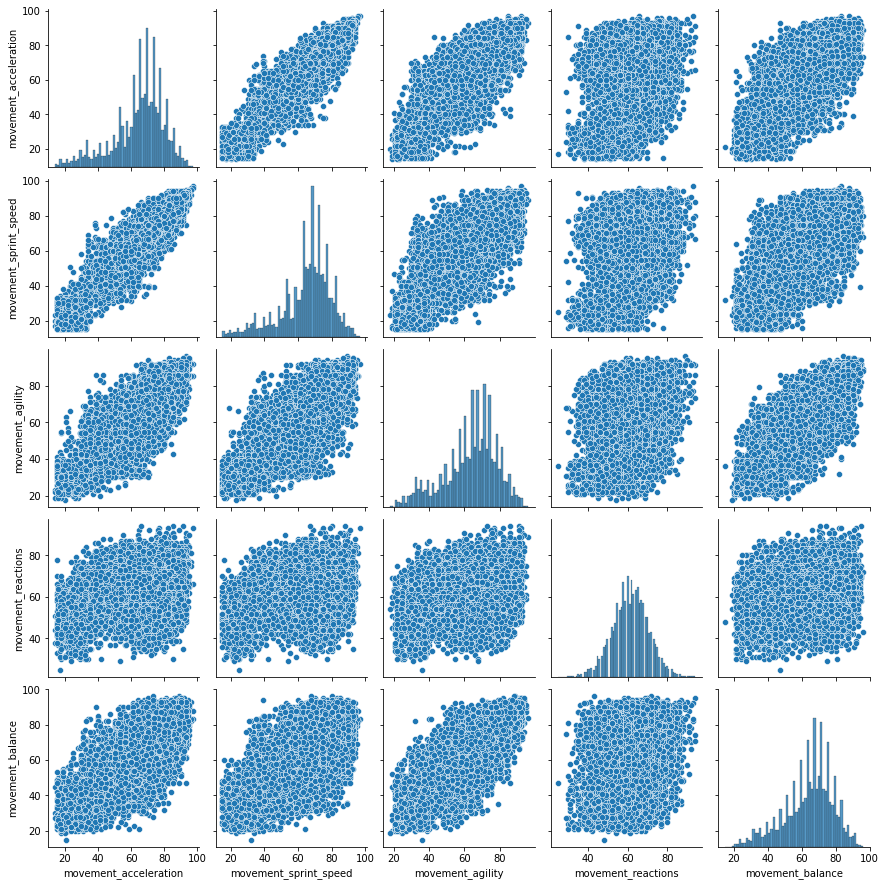

In [ ]:
col = ['movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

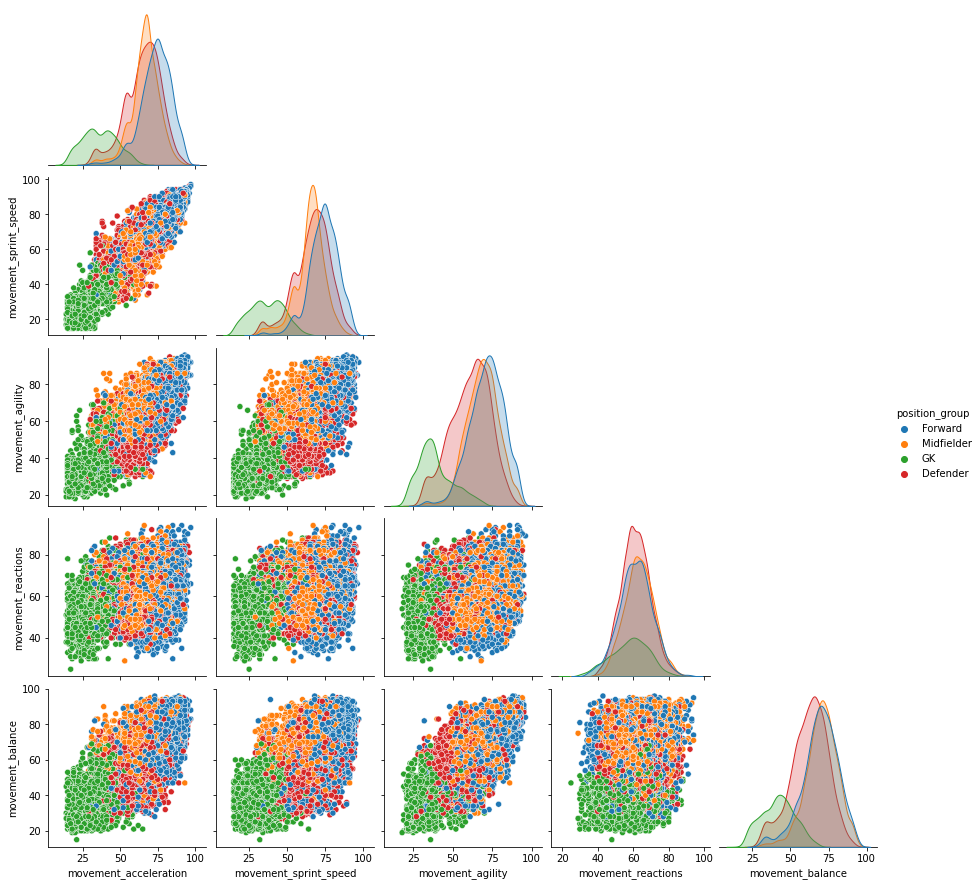

In [ ]:
col = ['movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance']
dat = df_numerical_columns[col]
dat = dat.join(position_group)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_4.jpg', bbox_inches = 'tight')

### Power

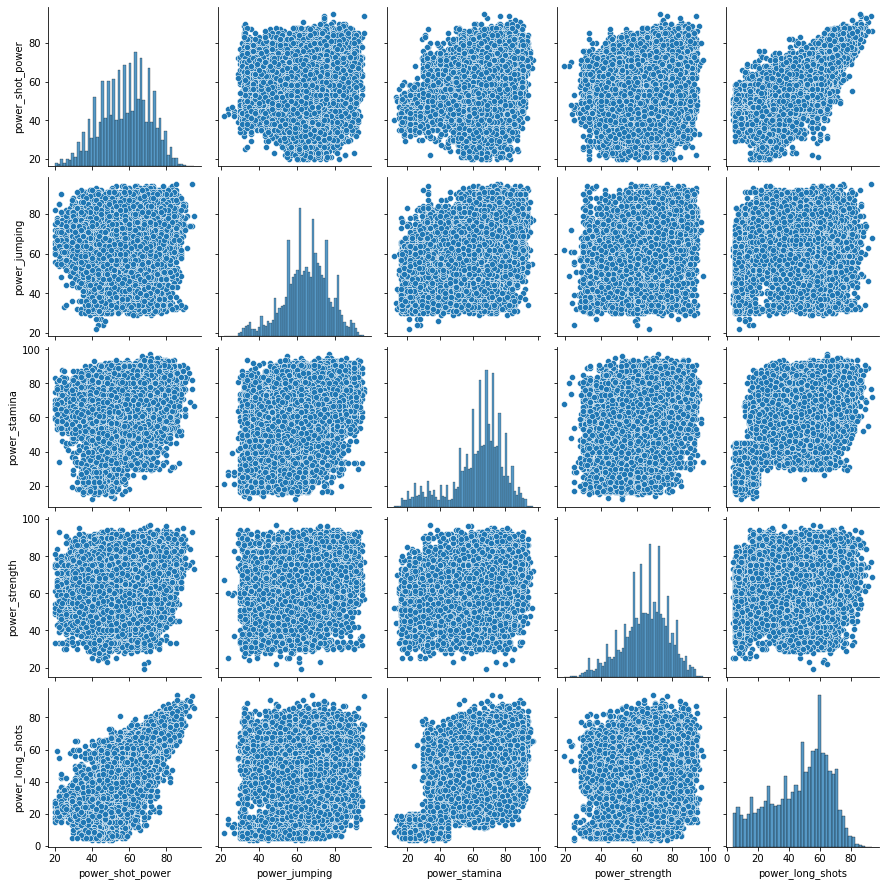

In [ ]:
col = ['power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

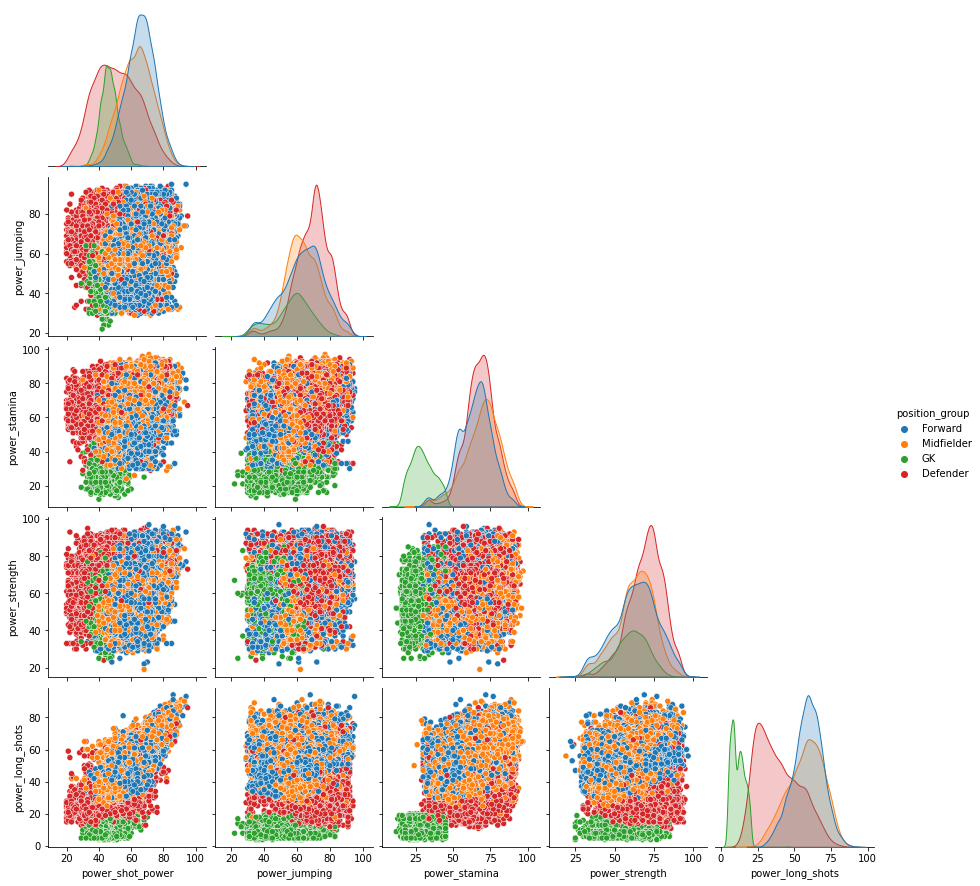

In [ ]:
col = ['power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots']
dat = df_numerical_columns[col]
dat = dat.join(position_group)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_5.jpg', bbox_inches = 'tight')

### Mentality

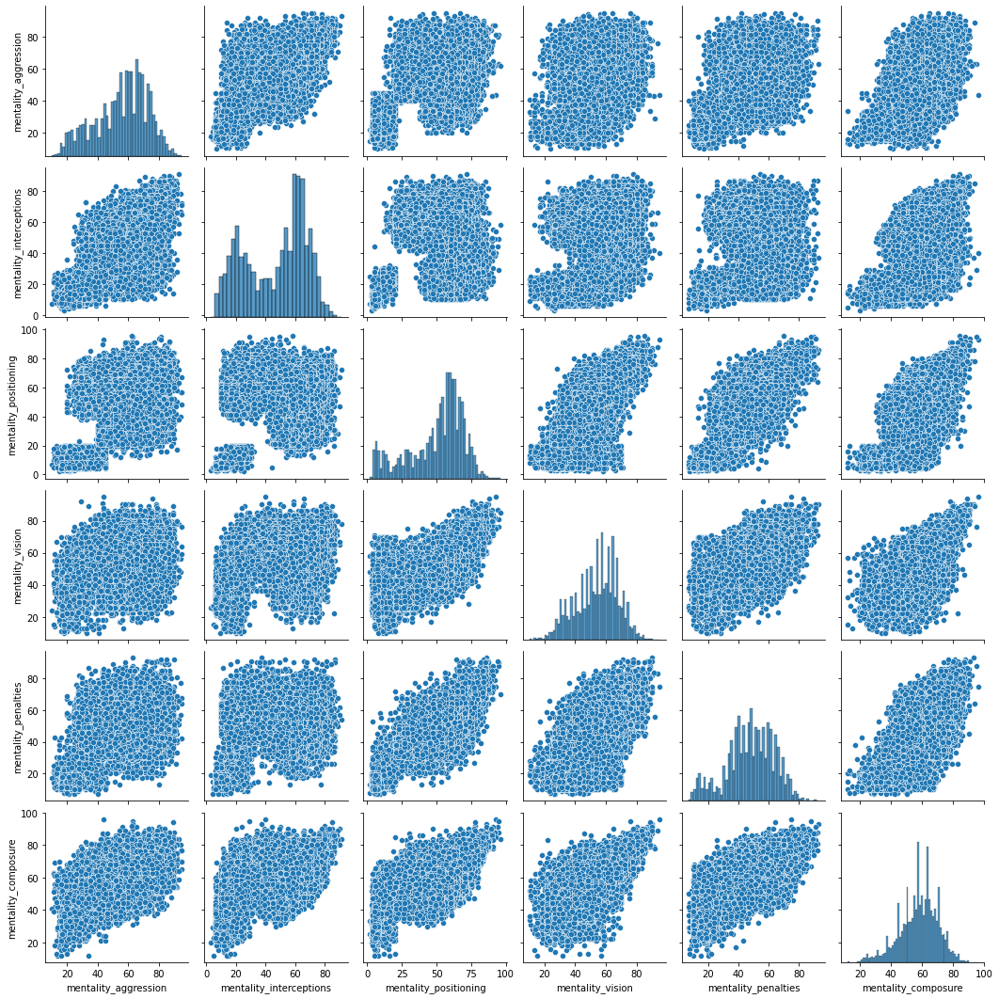

In [ ]:
col = ['mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

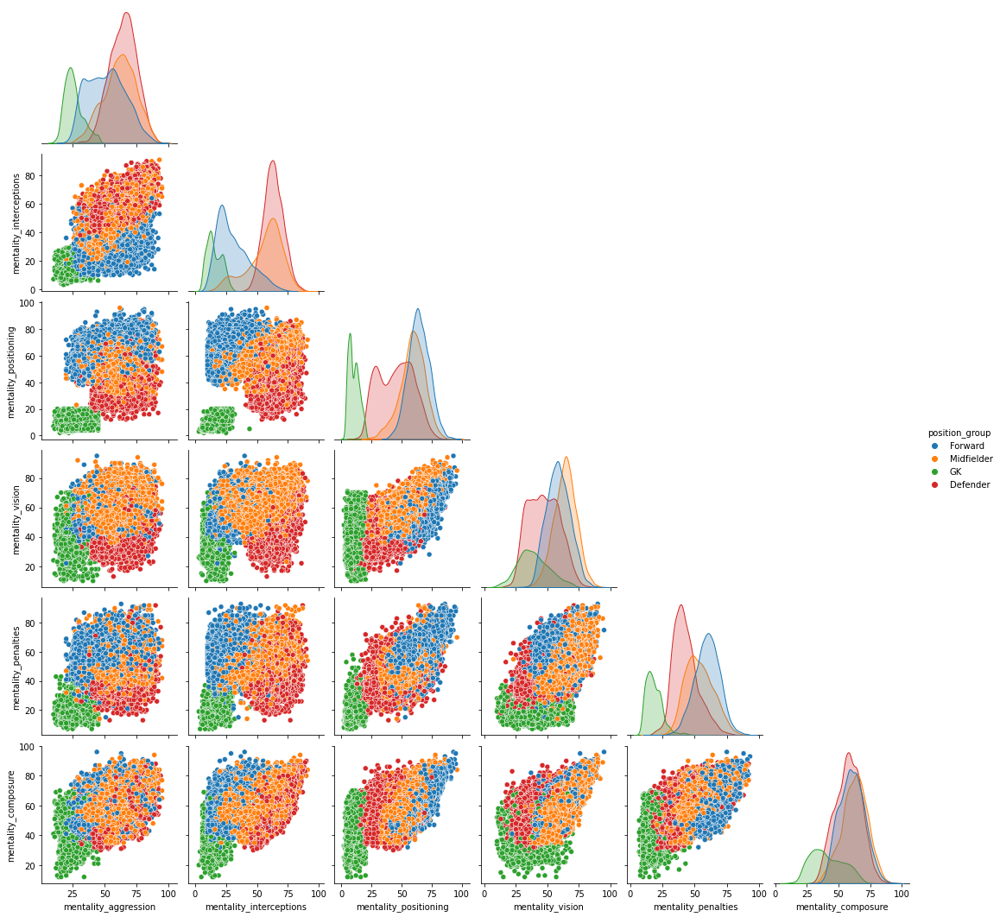

In [ ]:
col = ['mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure']
dat = df_numerical_columns[col]
dat = dat.join(position_group)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_6.jpg', bbox_inches = 'tight')

### Defending

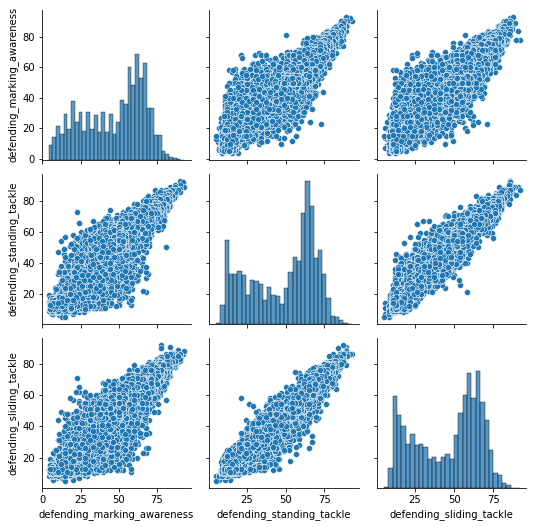

In [ ]:
col = ['defending_marking_awareness',
       'defending_standing_tackle', 'defending_sliding_tackle']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

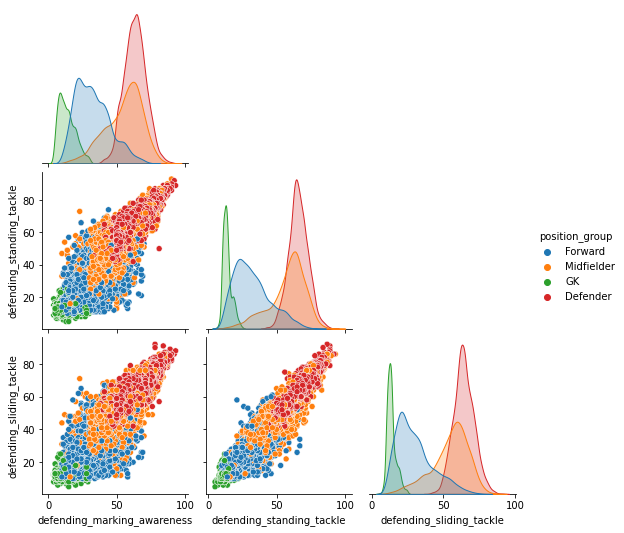

In [ ]:
col = ['defending_marking_awareness',
       'defending_standing_tackle', 'defending_sliding_tackle']
dat = df_numerical_columns[col]
dat = dat.join(position_group)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_7.jpg', bbox_inches = 'tight')

### Goalkeeping

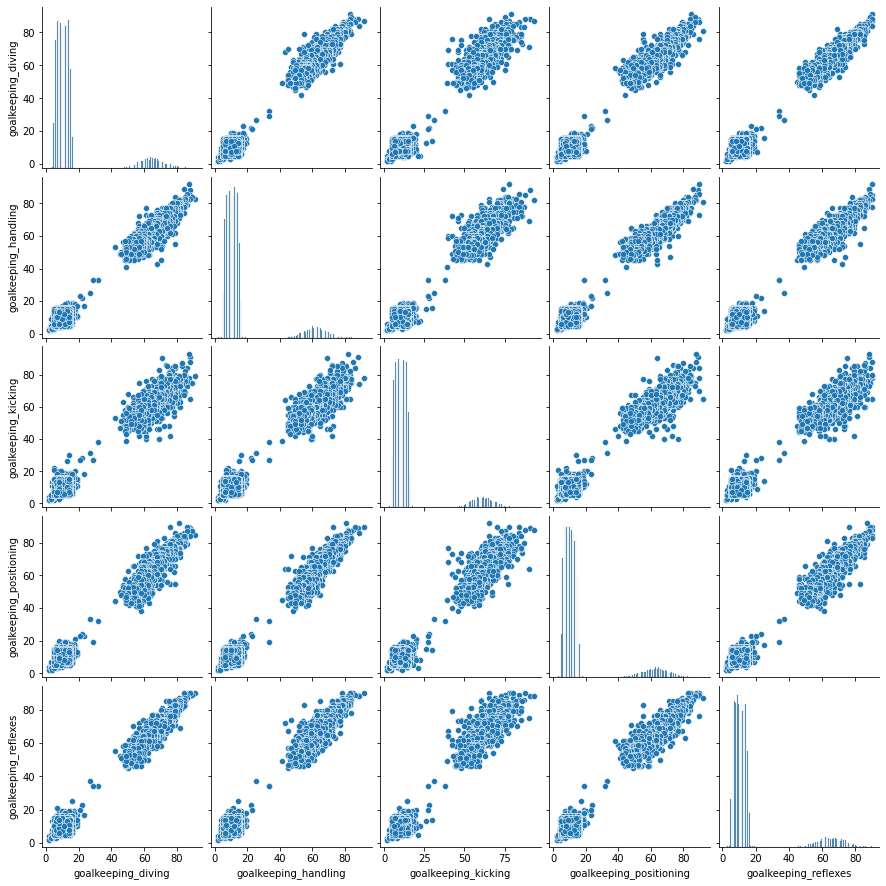

In [ ]:
col = ['goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking',
       'goalkeeping_positioning', 'goalkeeping_reflexes']
dat = df_numerical_columns[col]
sns.pairplot(dat)

<Figure size 720x720 with 0 Axes>

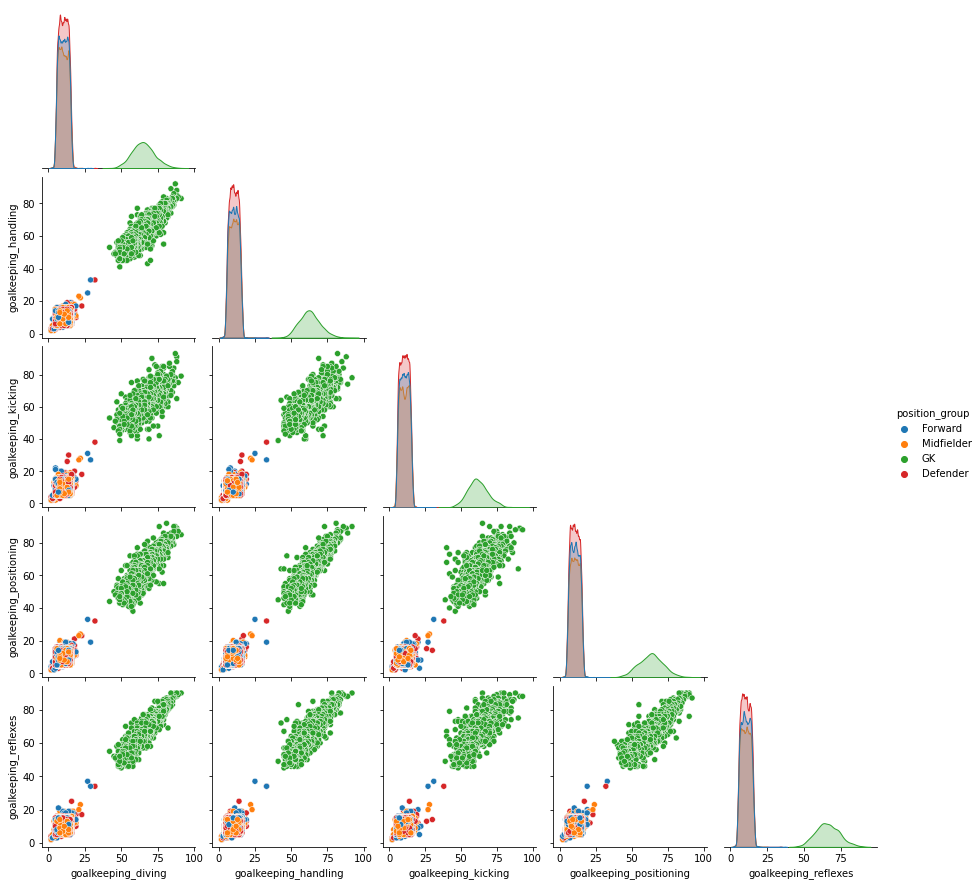

In [ ]:
col = ['goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking',
       'goalkeeping_positioning', 'goalkeeping_reflexes']
dat = df_numerical_columns[col]
dat = dat.join(position_group)
fig = plt.figure(figsize=(10,10))
sns.pairplot(dat, hue='position_group', corner=True)
plt.savefig('pairplot_8.jpg', bbox_inches = 'tight')

### Análisis:

En primera instancia se puede observar que la posición tendría cierta influencia en la forma que se agrupan los datos. Si se observa, por ejemplo, el primer subgrupo (sin keywords) se ve que al comparar variables como: "Deffending"-"pace" o "phisyc"-"shooting" los datos vinculados a jugadores que se ubican como delanteros o defensores tienedes a ubicarse próximos entre si. 
Por otra parte, el grupo más evidente que se forma en varios de los subgrupos analizados (attacking, skill, movement, power, mentality) es el de los arqueros, que tienen a conformar un evidente grupo o cluster.


# 3) Uso de dos técnicas de clustering

En primer lugar se guardan las variables que serán utilizadas para la entrenar los modelos de clustering

In [ ]:
#n=10000 #cantidad de jugadores a considerar

#df_n=data.loc[:n] #se reduce la base a los n primeros jugadores
df_n=data.copy()

#df_n=df_n[(df_n['overall']>70)]

skills_ratings = ['pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic', 'attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking_awareness',
       'defending_standing_tackle', 'defending_sliding_tackle',
       'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking',
       'goalkeeping_positioning', 'goalkeeping_reflexes']
print(len(skills_ratings), 'variables numéricas de desempeño según habilidad')

40 variables numéricas de desempeño según habilidad


Se crean dos vatiables de referencia: el jugador perfercto y el jugador promedio

In [ ]:
MachineGunDict={'short_name':'MachineGun','overall':99}
for skills in skills_ratings:
    MachineGunDict[skills]=99
    
df_n=df_n.append(MachineGunDict,ignore_index=True)

In [ ]:
JugadorPromedioDict={'short_name':'JugadorPromedio','overall':df_n.overall.mean()}
for skills in skills_ratings:
    JugadorPromedioDict[skills]=df_n[skills].mean()
    
df_n=df_n.append(JugadorPromedioDict,ignore_index=True)

Se crea un sub-dataset con las variables numéricas (skills) que será el utilizado para entrenar los modelos

In [ ]:
df_skills=df_n[skills_ratings] #base, sólo con desempeños según habilidad (numéricas)

In [ ]:
df_skills.head(4)

,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes
0,85.0,92.0,91.0,95.0,34.0,65.0,85.0,95.0,70.0,91.0,88.0,96.0,93.0,94.0,91.0,96.0,91.0,80.0,91.0,94.0,95.0,86.0,68.0,72.0,69.0,94.0,44.0,40.0,93.0,95.0,75.0,96.0,20.0,35.0,24.0,6.0,11.0,15.0,14.0,8.0
1,78.0,92.0,79.0,86.0,44.0,82.0,71.0,95.0,90.0,85.0,89.0,85.0,79.0,85.0,70.0,88.0,77.0,79.0,77.0,93.0,82.0,90.0,85.0,76.0,86.0,87.0,81.0,49.0,95.0,81.0,90.0,88.0,35.0,42.0,19.0,15.0,6.0,12.0,8.0,10.0
2,87.0,94.0,80.0,88.0,34.0,75.0,87.0,95.0,90.0,80.0,86.0,88.0,81.0,84.0,77.0,88.0,85.0,88.0,86.0,94.0,74.0,94.0,95.0,77.0,77.0,93.0,63.0,29.0,95.0,76.0,88.0,95.0,24.0,32.0,24.0,7.0,11.0,15.0,14.0,11.0
3,91.0,83.0,86.0,94.0,37.0,63.0,85.0,83.0,63.0,86.0,86.0,95.0,88.0,87.0,81.0,95.0,93.0,89.0,96.0,89.0,84.0,80.0,64.0,81.0,53.0,81.0,63.0,37.0,86.0,90.0,93.0,93.0,35.0,32.0,29.0,9.0,9.0,15.0,15.0,11.0


Se escalan y normalizan las columnas referentes a skills unicamente

In [ ]:
# Scaling the data to bring all the attributes to a comparable level

scaler = StandardScaler()
df_skills_scaled = scaler.fit_transform(df_skills)
  
# Normalizing the data so that 
# the data approximately follows a Gaussian distribution
df_skills_normalized = normalize(df_skills_scaled)
  
# Converting the numpy array into a pandas DataFrame

df_skills_normalized = pd.DataFrame(df_skills_normalized, columns = skills_ratings)


A las columnas normalizadas les sumamos las demás columnas del dataset para poder hacer el análisis respectivo

In [ ]:
df_skills_normalized=df_skills_normalized.join(df_n[categorical_variables])
df_skills_norm_all=df_skills_normalized.join(df_n['overall'])

In [ ]:
df_skills_norm_all.head(4)

,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,sofifa_id,player_url,short_name,long_name,player_positions,dob,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_joined,club_contract_valid_until,nationality_id,nationality_name,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_flag_url,position_group,overall
0,0.128905,0.236913,0.280818,0.282137,-0.091825,0.001500,0.155503,0.197141,0.083386,0.175554,0.204206,0.170031,0.199139,0.238487,0.199823,0.178309,0.137536,0.080863,0.146499,0.284927,0.170962,0.169366,0.020800,0.043714,0.024950,0.193153,-0.053842,-0.025336,0.172176,0.237982,0.136257,0.247859,-0.104278,-0.048659,-0.083580,-0.046884,-0.024424,-0.005063,-0.010362,-0.037599,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",1987-06-24,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,2021-08-10,2023.0,52,Argentina,Left,4,4,5,Medium/Low,Unique,Yes,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/flags/ar.png,Forward,93.0
1,0.085139,0.268412,0.204815,0.230958,-0.045278,0.166830,0.106542,0.223352,0.198211,0.161753,0.236437,0.140105,0.156542,0.223203,0.101034,0.158949,0.073018,0.085620,0.081473,0.312892,0.112282,0.219081,0.149354,0.071751,0.148690,0.186485,0.134561,0.010342,0.204211,0.177631,0.239697,0.221800,-0.051532,-0.025554,-0.116302,-0.007196,-0.054294,-0.021975,-0.043276,-0.032570,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,1988-08-21,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,2014-07-01,2023.0,37,Poland,Right,4,4,5,High/Medium,Unique,Yes,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/flags/pl.png,Forward,92.0
2,0.154112,0.265849,0.202025,0.236352,-0.098093,0.093191,0.175496,0.210597,0.186892,0.123332,0.208562,0.145613,0.156907,0.205533,0.134664,0.149872,0.113462,0.131599,0.128042,0.304375,0.058632,0.232214,0.210593,0.072893,0.080086,0.201979,0.037172,-0.072062,0.192549,0.136509,0.215282,0.257821,-0.094647,-0.063931,-0.089285,-0.045273,-0.026091,-0.005408,-0.011069,-0.025983,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",1985-02-05,11.0,Manchester United,English Premier League,1.0,ST,7.0,2021-08-27,2023.0,38,Portugal,Right,4,5,5,High/Low,Unique,Yes,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/flags/pt.png,Forward,91.0
3,0.191244,0.200159,0.261358,0.298850,-0.083354,-0.017102,0.169953,0.16280

In [ ]:
#Enumeramos las skills para luego poder indicar el respetivo indice al momento de visualizar los clusters
pd.DataFrame(enumerate(skills_ratings),columns=['Indice','Skill'])

,Indice,Skill
0,0,pace
1,1,shooting
2,2,passing
3,3,dribbling
4,4,defending
5,5,physic
6,6,attacking_crossing
7,7,attacking_finishing
8,8,attacking_heading_accuracy
9,9,attacking_short_passing


Seteamos las skills que se visualizarán luego de crearse los clusters

In [ ]:
#Eligo dos números entre 0 y  de n_skills-1
skill_1=skills_ratings[32] #1, 27, 33, 2, 4
skill_2=skills_ratings[33] #5, 28, 34, 3, 5

## K-means:

### Clusters con todos los datos

Para la elección del hiperparámetro utilizamos el método del codo, que nos indica el número de clusters a conformar 

Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

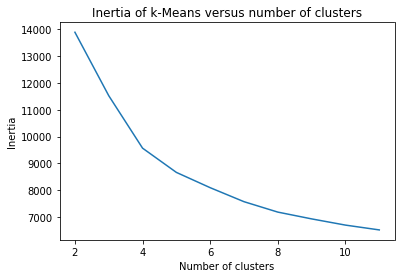

In [ ]:
#Prueba: para elegir el hiperparámetro n_clusters, variando de 2 a 11 clusters
scores = [KMeans(n_clusters=i).fit(df_skills_norm_all[skills_ratings]).inertia_ for i in range(2,12)]

plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

Del gráfico de arriba se desprende que el número ideal de clusters debería ser 4.

In [ ]:
# Número de clusters buscado
n_clust = 4

km = KMeans(n_clusters=n_clust)
km.fit(df_skills_norm_all[skills_ratings]) #utiliza todas las habilidades: 40 dimensiones

# Etiquetas asignadas por el algoritmo
clusters = km.labels_
print('Suma de los cuadrados de las distancias al centro de cada cluster=Inertia= ', km.inertia_)

Suma de los cuadrados de las distancias al centro de cada cluster=Inertia=  9565.375730560387


In [ ]:
df_km_clusters=df_skills_norm_all.copy()
df_km_clusters['kmeans_clusters'] = km.labels_ #clusters
print('Kmeans encontró: ', max(km.labels_)+1, 'clusters, nosotros forzamos la cantidad')
df_km_clusters.head(4)

Kmeans encontró:  4 clusters, nosotros forzamos la cantidad


,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,sofifa_id,player_url,short_name,long_name,player_positions,dob,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_joined,club_contract_valid_until,nationality_id,nationality_name,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_flag_url,position_group,overall,kmeans_clusters
0,0.128905,0.236913,0.280818,0.282137,-0.091825,0.001500,0.155503,0.197141,0.083386,0.175554,0.204206,0.170031,0.199139,0.238487,0.199823,0.178309,0.137536,0.080863,0.146499,0.284927,0.170962,0.169366,0.020800,0.043714,0.024950,0.193153,-0.053842,-0.025336,0.172176,0.237982,0.136257,0.247859,-0.104278,-0.048659,-0.083580,-0.046884,-0.024424,-0.005063,-0.010362,-0.037599,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",1987-06-24,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,2021-08-10,2023.0,52,Argentina,Left,4,4,5,Medium/Low,Unique,Yes,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/flags/ar.png,Forward,93.0,0
1,0.085139,0.268412,0.204815,0.230958,-0.045278,0.166830,0.106542,0.223352,0.198211,0.161753,0.236437,0.140105,0.156542,0.223203,0.101034,0.158949,0.073018,0.085620,0.081473,0.312892,0.112282,0.219081,0.149354,0.071751,0.148690,0.186485,0.134561,0.010342,0.204211,0.177631,0.239697,0.221800,-0.051532,-0.025554,-0.116302,-0.007196,-0.054294,-0.021975,-0.043276,-0.032570,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,1988-08-21,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,2014-07-01,2023.0,37,Poland,Right,4,4,5,High/Medium,Unique,Yes,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/flags/pl.png,Forward,92.0,0
2,0.154112,0.265849,0.202025,0.236352,-0.098093,0.093191,0.175496,0.210597,0.186892,0.123332,0.208562,0.145613,0.156907,0.205533,0.134664,0.149872,0.113462,0.131599,0.128042,0.304375,0.058632,0.232214,0.210593,0.072893,0.080086,0.201979,0.037172,-0.072062,0.192549,0.136509,0.215282,0.257821,-0.094647,-0.063931,-0.089285,-0.045273,-0.026091,-0.005408,-0.011069,-0.025983,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",1985-02-05,11.0,Manchester United,English Premier League,1.0,ST,7.0,2021-08-27,2023.0,38,Portugal,Right,4,5,5,High/Low,Unique,Yes,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/flags/pt.png,Forward,91.0,0
3,0.191244,0.200159,0.261358,0.298850,-0.083354,-0.0

In [ ]:
bool_crack=df_km_clusters["overall"] > 85
bool_no_crack=df_km_clusters["overall"]<86


In [ ]:
kmean_clusters = go.Scatter(x=df_km_clusters[skill_1], y=df_km_clusters[skill_2],
                           mode='markers',
                        text=df_km_clusters.loc[:,'position_group'],
                           marker=dict(
                                size=5,
                                color = clusters.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

#crack =go.Scatter(x=df_km_clusters.loc[bool_crack,skill_1], y=df_km_clusters.loc[bool_crack,skill_2],name='Ckacks!!',
#                      text=df_km_clusters.loc[bool_crack,'short_name'],
#                      textfont=dict(family='sans serif',size=10,color='black'),
#                      opacity=0.9,mode='text')

data=[kmean_clusters]#,crack]

layout = go.Layout(title="Clustering K means ",titlefont=dict(size=20),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=1000,height=650)

fig = go.Figure(data=data, layout=layout)

In [ ]:
#En Colab:
fig.show(renderer="colab")

In [ ]:
#En Jupyter Ntb abre en otra ventana, 
#plot(fig)

In [ ]:
#en Jupyter Ntb, abre en la ntb
#iplot(fig)

In [ ]:
#En Jupyter:
#iplot(fig)
#plot(fig)

### Clusters sin datos de arqueros

In [ ]:
#datos sin los arqueros
#n=10000
#df_no_gk=df.loc[:n]
df_km_no_GK=df_skills_norm_all[(df_skills_norm_all["position_group"]!='GK')]#&(df_skills_norm_all['overall']>70)]

skills_ratings = ['pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic', 'attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking_awareness',
       'defending_standing_tackle', 'defending_sliding_tackle',
       'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking',
       'goalkeeping_positioning', 'goalkeeping_reflexes']
df_skills_no_GK=df_km_no_GK[skills_ratings]

Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

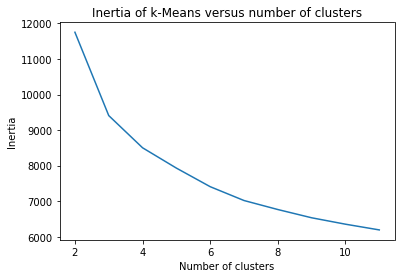

In [ ]:
#Prueba: para elegir el hiperparámetro n_clusters, variando de 2 a 11 clusters
scores = [KMeans(n_clusters=i).fit(df_km_no_GK[skills_ratings]).inertia_ for i in range(2,12)]

plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

In [ ]:
# Número de clusters buscado
n_clust = 3

km = KMeans(n_clusters=n_clust)
km.fit(df_skills_no_GK)

# Recuperacion de etiquetas
clusters = km.labels_

In [ ]:
df_km_clusters_noGK=df_km_no_GK.copy()
df_km_clusters_noGK['kmeans_clusters'] = km.labels_ #clusters
print('Kmeans encontró: ', max(km.labels_)+1, 'clusters, nosotros forzamos la cantidad')
df_km_clusters_noGK.head(4)

Kmeans encontró:  3 clusters, nosotros forzamos la cantidad


,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,sofifa_id,player_url,short_name,long_name,player_positions,dob,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_joined,club_contract_valid_until,nationality_id,nationality_name,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_flag_url,position_group,overall,kmeans_clusters
0,0.128905,0.236913,0.280818,0.282137,-0.091825,0.001500,0.155503,0.197141,0.083386,0.175554,0.204206,0.170031,0.199139,0.238487,0.199823,0.178309,0.137536,0.080863,0.146499,0.284927,0.170962,0.169366,0.020800,0.043714,0.024950,0.193153,-0.053842,-0.025336,0.172176,0.237982,0.136257,0.247859,-0.104278,-0.048659,-0.083580,-0.046884,-0.024424,-0.005063,-0.010362,-0.037599,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",1987-06-24,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,2021-08-10,2023.0,52,Argentina,Left,4,4,5,Medium/Low,Unique,Yes,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/flags/ar.png,Forward,93.0,0
1,0.085139,0.268412,0.204815,0.230958,-0.045278,0.166830,0.106542,0.223352,0.198211,0.161753,0.236437,0.140105,0.156542,0.223203,0.101034,0.158949,0.073018,0.085620,0.081473,0.312892,0.112282,0.219081,0.149354,0.071751,0.148690,0.186485,0.134561,0.010342,0.204211,0.177631,0.239697,0.221800,-0.051532,-0.025554,-0.116302,-0.007196,-0.054294,-0.021975,-0.043276,-0.032570,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,1988-08-21,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,2014-07-01,2023.0,37,Poland,Right,4,4,5,High/Medium,Unique,Yes,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/flags/pl.png,Forward,92.0,0
2,0.154112,0.265849,0.202025,0.236352,-0.098093,0.093191,0.175496,0.210597,0.186892,0.123332,0.208562,0.145613,0.156907,0.205533,0.134664,0.149872,0.113462,0.131599,0.128042,0.304375,0.058632,0.232214,0.210593,0.072893,0.080086,0.201979,0.037172,-0.072062,0.192549,0.136509,0.215282,0.257821,-0.094647,-0.063931,-0.089285,-0.045273,-0.026091,-0.005408,-0.011069,-0.025983,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",1985-02-05,11.0,Manchester United,English Premier League,1.0,ST,7.0,2021-08-27,2023.0,38,Portugal,Right,4,5,5,High/Low,Unique,Yes,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/flags/pt.png,Forward,91.0,0
3,0.191244,0.200159,0.261358,0.298850,-0.083354,-0.0

In [ ]:
#data=[]
bool_crack=df_km_clusters_noGK["overall"] > 85
bool_no_crack=df_km_clusters_noGK["overall"]<86

In [ ]:
kmean_clusters = go.Scatter(x=df_km_clusters_noGK[skill_1], y=df_km_clusters_noGK[skill_2],
                           mode='markers',
                        text=df_km_clusters_noGK.loc[:,'position_group'],
                           marker=dict(
                                size=5,
                                color = clusters.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

#crack =go.Scatter(x=df_km_clusters_noGK.loc[bool_crack,skill_1], y=df_km_clusters_noGK.loc[bool_crack,skill_2],name='Top players',
#                      text=df_km_clusters_noGK.loc[bool_crack,'short_name'],
#                      textfont=dict(family='sans serif',size=10,color='black'),
#                      opacity=0.9,mode='text')

data=[kmean_clusters]#,crack]

layout = go.Layout(title="Clustering K means ",titlefont=dict(size=20),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=1000,height=1000)

fig = go.Figure(data=data, layout=layout)

In [ ]:
#En Colab
fig.show(renderer="colab")

In [ ]:
#en Jupyter:
#plot(fig)

## DBSCAN:

### Clusters con todos los datos

A los fines de configurar los hiperparámetros se optó por utilizar la metodología planteada en el siguiente artículo:  
* http://www.sefidian.com/2020/12/18/how-to-determine-epsilon-and-minpts-parameters-of-dbscan-clustering/    

Allí se plantea que el valor de *min_samples* para dataset con muchas dimensiones, debería ser **2xD** (D es la cantidad de dimensiones).  
Mientras que para calcular el valor de *eps* se utiliza la gráfica que se observa más abajo, donde el *eje y* determina el valor de *eps* ya que indica la distancia ideal entre los k-neighbours (donde el número de neighbours es determinado por el valor del parámetro *min_samples*). El valor de *eps* es el de máxima curvatura, en este caso sería entre 0.4 y 0.6

In [ ]:
neigh = NearestNeighbors(n_neighbors=80)
nbrs = neigh.fit(df_skills_norm_all[skills_ratings])
distances, indices = nbrs.kneighbors(df_skills_norm_all[skills_ratings])

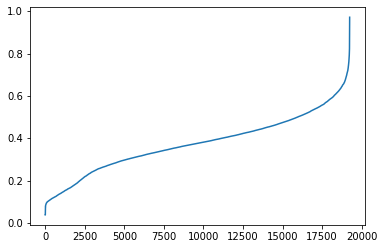

In [ ]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]

plt.plot(distances)

In [ ]:
# Numpy array of all the cluster labels assigned to each data point
db_default = DBSCAN(eps = 0.4, min_samples =80).fit(df_skills_norm_all[skills_ratings])
#core_samples_mask = np.zeros_like(db_default.labels_, dtype=bool)
#core_samples_mask[db_default.core_sample_indices_] = True
labels = db_default.labels_

In [ ]:
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)

Estimated number of clusters: 4
Estimated number of noise points: 12795


In [ ]:
df_db_clusters=df_skills_norm_all.copy()
df_db_clusters['dbscan_clusters'] = db_default.labels_ #clusters
#print('Dbscan encontró: ', max(db_default.labels_), 'clusters')
df_db_clusters.head(4)

,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,sofifa_id,player_url,short_name,long_name,player_positions,dob,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_joined,club_contract_valid_until,nationality_id,nationality_name,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_flag_url,position_group,overall,dbscan_clusters
0,0.128905,0.236913,0.280818,0.282137,-0.091825,0.001500,0.155503,0.197141,0.083386,0.175554,0.204206,0.170031,0.199139,0.238487,0.199823,0.178309,0.137536,0.080863,0.146499,0.284927,0.170962,0.169366,0.020800,0.043714,0.024950,0.193153,-0.053842,-0.025336,0.172176,0.237982,0.136257,0.247859,-0.104278,-0.048659,-0.083580,-0.046884,-0.024424,-0.005063,-0.010362,-0.037599,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",1987-06-24,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,2021-08-10,2023.0,52,Argentina,Left,4,4,5,Medium/Low,Unique,Yes,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/flags/ar.png,Forward,93.0,0
1,0.085139,0.268412,0.204815,0.230958,-0.045278,0.166830,0.106542,0.223352,0.198211,0.161753,0.236437,0.140105,0.156542,0.223203,0.101034,0.158949,0.073018,0.085620,0.081473,0.312892,0.112282,0.219081,0.149354,0.071751,0.148690,0.186485,0.134561,0.010342,0.204211,0.177631,0.239697,0.221800,-0.051532,-0.025554,-0.116302,-0.007196,-0.054294,-0.021975,-0.043276,-0.032570,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,1988-08-21,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,2014-07-01,2023.0,37,Poland,Right,4,4,5,High/Medium,Unique,Yes,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/flags/pl.png,Forward,92.0,0
2,0.154112,0.265849,0.202025,0.236352,-0.098093,0.093191,0.175496,0.210597,0.186892,0.123332,0.208562,0.145613,0.156907,0.205533,0.134664,0.149872,0.113462,0.131599,0.128042,0.304375,0.058632,0.232214,0.210593,0.072893,0.080086,0.201979,0.037172,-0.072062,0.192549,0.136509,0.215282,0.257821,-0.094647,-0.063931,-0.089285,-0.045273,-0.026091,-0.005408,-0.011069,-0.025983,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",1985-02-05,11.0,Manchester United,English Premier League,1.0,ST,7.0,2021-08-27,2023.0,38,Portugal,Right,4,5,5,High/Low,Unique,Yes,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/flags/pt.png,Forward,91.0,0
3,0.191244,0.200159,0.261358,0.298850,-0.083354,-0.0

In [ ]:
dbscan_clusters = go.Scatter(x=df_db_clusters[skill_1], y=df_db_clusters[skill_2],
                           mode='markers',
                        text=df_db_clusters.loc[:,'position_group'],
                           marker=dict(
                                size=5,
                                color = labels.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

#rack =go.Scatter(x=df_db_clusters.loc[bool_crack,skill_1], y=df_db_clusters.loc[bool_crack,skill_2],name='Ckacks!!',
#                      text=df_db_clusters.loc[bool_crack,'short_name'],
#                      textfont=dict(family='sans serif',size=10,color='black'),
#                      opacity=0.9,mode='text')
#
data=[dbscan_clusters]#,crack]

layout = go.Layout(title="Clustering DBSCAN ",titlefont=dict(size=20),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=1000,height=650)

fig = go.Figure(data=data, layout=layout)

In [ ]:
#En Colab:
fig.show(renderer="colab")

NOTA: Los puntos rojos que se observan son ruido.

### Clusters sin datos de arqueros

In [ ]:
neigh = NearestNeighbors(n_neighbors=80)
nbrs = neigh.fit(df_km_no_GK[skills_ratings])
distances, indices = nbrs.kneighbors(df_km_no_GK[skills_ratings])

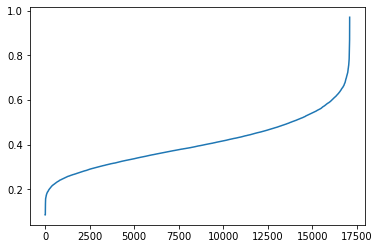

In [ ]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]

plt.plot(distances)

In [ ]:
#Datos sin arqueros
# Numpy array of all the cluster labels assigned to each data point
db_default = DBSCAN(eps = 0.4, min_samples =80).fit(df_km_no_GK[skills_ratings])
#core_samples_mask = np.zeros_like(db_default.labels_, dtype=bool)
#core_samples_mask[db_default.core_sample_indices_] = True
labels = db_default.labels_

In [ ]:
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)

Estimated number of clusters: 3
Estimated number of noise points: 12795


In [ ]:
df_db_clusters_noGK=df_km_no_GK.copy()
df_db_clusters_noGK['dbscan'] = db_default.labels_ #clusters
#print('Dbscan encontró: ', max(db_default.labels_), 'clusters')
df_db_clusters_noGK.head(4)

,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,sofifa_id,player_url,short_name,long_name,player_positions,dob,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_joined,club_contract_valid_until,nationality_id,nationality_name,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_flag_url,position_group,overall,dbscan
0,0.128905,0.236913,0.280818,0.282137,-0.091825,0.001500,0.155503,0.197141,0.083386,0.175554,0.204206,0.170031,0.199139,0.238487,0.199823,0.178309,0.137536,0.080863,0.146499,0.284927,0.170962,0.169366,0.020800,0.043714,0.024950,0.193153,-0.053842,-0.025336,0.172176,0.237982,0.136257,0.247859,-0.104278,-0.048659,-0.083580,-0.046884,-0.024424,-0.005063,-0.010362,-0.037599,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",1987-06-24,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,2021-08-10,2023.0,52,Argentina,Left,4,4,5,Medium/Low,Unique,Yes,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/flags/ar.png,Forward,93.0,0
1,0.085139,0.268412,0.204815,0.230958,-0.045278,0.166830,0.106542,0.223352,0.198211,0.161753,0.236437,0.140105,0.156542,0.223203,0.101034,0.158949,0.073018,0.085620,0.081473,0.312892,0.112282,0.219081,0.149354,0.071751,0.148690,0.186485,0.134561,0.010342,0.204211,0.177631,0.239697,0.221800,-0.051532,-0.025554,-0.116302,-0.007196,-0.054294,-0.021975,-0.043276,-0.032570,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,1988-08-21,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,2014-07-01,2023.0,37,Poland,Right,4,4,5,High/Medium,Unique,Yes,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/flags/pl.png,Forward,92.0,0
2,0.154112,0.265849,0.202025,0.236352,-0.098093,0.093191,0.175496,0.210597,0.186892,0.123332,0.208562,0.145613,0.156907,0.205533,0.134664,0.149872,0.113462,0.131599,0.128042,0.304375,0.058632,0.232214,0.210593,0.072893,0.080086,0.201979,0.037172,-0.072062,0.192549,0.136509,0.215282,0.257821,-0.094647,-0.063931,-0.089285,-0.045273,-0.026091,-0.005408,-0.011069,-0.025983,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",1985-02-05,11.0,Manchester United,English Premier League,1.0,ST,7.0,2021-08-27,2023.0,38,Portugal,Right,4,5,5,High/Low,Unique,Yes,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/flags/pt.png,Forward,91.0,0
3,0.191244,0.200159,0.261358,0.298850,-0.083354,-0.017102,0.1

In [ ]:
dbscan_clusters = go.Scatter(x=df_db_clusters_noGK[skill_1], y=df_db_clusters_noGK[skill_2],
                           mode='markers',
                        text=df_db_clusters_noGK.loc[:,'position_group'],
                           marker=dict(
                                size=5,
                                color = labels.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

#crack =go.Scatter(x=df_db_clusters_noGK.loc[bool_crack,skill_1], y=df_db_clusters_noGK.loc[bool_crack,skill_2],name='Ckacks!!',
#                      text=df_db_clusters_noGK.loc[bool_crack,'short_name'],
#                      textfont=dict(family='sans serif',size=10,color='black'),
#                      opacity=0.9,mode='text')

data=[dbscan_clusters]#,crack]

layout = go.Layout(title="Clustering DBSCAN ",titlefont=dict(size=20),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=1000,height=650)

fig = go.Figure(data=data, layout=layout)

In [ ]:
#En Colab:
fig.show(renderer="colab")

NOTA: Los puntos rojos que se observan son ruido.

#4) Evaluación y Análisis de los clusters encontrados.

Luego de iterar entre diferentes variables a los fines de evaluar y analizar los clustes que se fueron conformando podemos detallar los siguientes puntos:
* En muchas de las variables comparadas se observa que los grupos encontrados por k-means son más definidos, aunque es relevante recordar que los clusters son un hiperparámetro que se define previamente (aún cuando en nuestro caso lo seteamos en base al resultado obtenido por el método del codo). Sin embargo, en términos generales en ámbos métodos los clusters encotnrados no necesariamente respetan la posición de los jugadores. Es decir, dentro de cada clusters se suelen agrupar jugadores ubicados en distintas posiciones por lo que esta variable no representa por si mimas un punto últil para la conformación de los clusters mediante los métodos utilizados.
* Otro punto interesante que se pudo observar es que el método empleado para elegir el hiperparámetro de DBSCAN (el eps) conllevó a que al entrenar el método se obtuviera la misma cantidad de clusters que los elegidos para k-means. Es decir, el mismo algoritmo de dbscan obtuvo la misma cantidad de clusters que los seteados para k-means. Pero esto se logró cuando eps=0.4, al elebar eps a 0.6 ya el algoritmo solo lograba encontrar un solo cluster.

#5) Pregunta: ¿Se realizó alguna normalización o escalado de la base? ¿Por qué ?

Si se nomalizó y escalo la base los fines de prevenir que alguna de las variables utilizadas se transfomre en la dominante generando ruido en la creación de los clusters

#6) Uso de alguna transformación (proyección, Embedding) para visualizar los resultados y/o usarla como preprocesado para aplicar alguna técnica de clustering.

A continuación utilizaremos PCA para generar 4 componentes en base a las variables numéricas (skills). Para ello quitaremos los registros vinculados a Arqueros (GK) así como los variables específicas de esta posición (aquellas que comienzan con la keyword "goalkeeping")

In [ ]:
df_acp=df_skills_norm_all[(df_skills_norm_all["position_group"]!='GK')]

skills_ratings_noGK = ['pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic', 'attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking_awareness',
       'defending_standing_tackle', 'defending_sliding_tackle']

In [ ]:
X=df_acp[skills_ratings_noGK] # Datos para proyectar
print('los datos tienen dimesión n= ',len(skills_ratings_noGK))

los datos tienen dimesión n=  35


In [ ]:
pca=decomposition.PCA(n_components=4)

pca.fit(X) #input data is centered but not scaled for each feature before applying the SVD

# proporción de varianza
print('proporción de varianza por componente: ', pca.explained_variance_ratio_)
# proporción de varianza acumulada
print ('proporción de varianza por componente acumulada: ', pca.explained_variance_ratio_.cumsum())

X_projected=pca.transform(X) #numpy array
print ('tamaño de los datos: ', X_projected.shape)

proporción de varianza por componente:  [0.33305634 0.24672012 0.11324741 0.07689889]
proporción de varianza por componente acumulada:  [0.33305634 0.57977646 0.69302387 0.76992275]
tamaño de los datos:  (17109, 4)


In [ ]:
pcs=pca.components_  #"composición" de las primeras componentes, 
print(pcs)  # el aporte/pesos de las variables: skills_ratings

[[-0.16868922 -0.320471   -0.23797405 -0.28455908  0.1585035   0.04713385
  -0.14259709 -0.24001136  0.02789762 -0.10215931 -0.22273318 -0.16474059
  -0.20495845 -0.19029423 -0.09245167 -0.13189652 -0.12260428 -0.10576558
  -0.17381498 -0.12371766 -0.13094901 -0.25195103  0.04202165 -0.04453232
   0.0703927  -0.22616268  0.04837366  0.12407919 -0.19712139 -0.23328294
  -0.18763675 -0.14698025  0.12317162  0.13376025  0.14394624]
 [ 0.07527717 -0.00255787 -0.21313053 -0.09946813 -0.36033028 -0.31579738
  -0.10139342  0.04256662 -0.12382146 -0.15078507  0.00692178 -0.03753397
  -0.07335058 -0.08448776 -0.20446933 -0.08217906  0.05519611  0.04824735
   0.01213903 -0.23808822  0.03224693 -0.09060483 -0.14841538 -0.1660091
  -0.20510803 -0.04603943 -0.25298527 -0.29944568 -0.01291035 -0.10845197
   0.01201185 -0.1843031  -0.28228116 -0.27800798 -0.27355605]
 [-0.27081664  0.18645082 -0.11134971 -0.0937046  -0.16131838  0.30363638
  -0.17357297  0.12602991  0.22667096 -0.04279653  0.13262779

En el siguiente gráfico se puede visualizar la "participación" de cada variable en las dos primeras componentes obtenidas

In [ ]:
#Graph 1
data=[]

for i, (x,y) in enumerate(zip(pcs[0,:],pcs[1,:])):
    graph=go.Scatter(x=[0,x],y=[0,y],text=X.columns[i],
                     mode='lines+markers+text',textposition='top left',textfont=dict(family='sans serif',size=15))
    data.append(graph)

layout = go.Layout(title="ACP - Fifa Skills",titlefont=dict(size=20),
            xaxis=dict(title='Componente 1'),
            yaxis=dict(title='Componente 2'),
            autosize=False, width=1050,height=750,
            showlegend=False)

fig = go.Figure(data=data, layout=layout)
#plot(fig)

In [ ]:
#En Colab
fig.show(renderer="colab")

El siguiente gráfico permite hacer un análisis visual utilizando como variables de comparación las dos primeras componentes

In [ ]:
#Graph 2
#Choose your player
recherche_joueur=df_acp["short_name"]=='L. Messi'

bool_crack=df_acp["overall"] > 85
bool_no_crack=df_acp["overall"]<86
bool_machinegun=df_acp["short_name"]=='MachineGun'

palette=['navy','red','#A2D5F2','orange','green','pink']  
data=[]

acp_crack =go.Scatter(x=X_projected[bool_crack,0], y=X_projected[bool_crack,1],name='Crack',
                      text=df_acp.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=15,color='black'),
                      opacity=0.9,marker=dict(color=palette[2],size=7),mode='markers+text')

acp_no_crack =go.Scatter(x=X_projected[bool_no_crack,0], y=X_projected[bool_no_crack,1],name='Average player',
                         text=df_acp.loc[bool_no_crack,'short_name'],
                         opacity=0.6,marker=dict(color=palette[1],size=3),mode='markers')

acp_machinegun =go.Scatter(x=X_projected[bool_machinegun,0], y=X_projected[bool_machinegun,1],name='Perfect player',
                           textfont=dict(family='sans serif',size=20,color='black'),
                           opacity=0.6,marker=dict(color=palette[3],size=30),mode='markers+text')


joueur_recherche =go.Scatter(x=X_projected[recherche_joueur,0], y=X_projected[recherche_joueur,1],name='Searched player',
                           text=df_acp.loc[recherche_joueur,'short_name'],
                            textfont=dict(family='sans serif',size=20,color='black'),
                           opacity=1,marker=dict(color=palette[4],size=40),mode='markers+text')

data=[acp_no_crack,acp_crack,acp_machinegun,joueur_recherche]

layout = go.Layout(title="ACP - Fifa Players",titlefont=dict(size=20),
                xaxis=dict(title='Componente 1'),
                yaxis=dict(title='componente 2'),
                autosize=False, width=1000,height=750)

fig = go.Figure(data=data, layout=layout)

#plot(fig)

In [ ]:
#En Colab
fig.show(renderer="colab")

Del grafico anterior es dificil encontrar a primera vista una conformación de grupos o clusters, por lo que acontinuación utilizaremos DBSCAN para ver si el algoritmo encuentra o logra conformar clusters entre los datos. Para ello como primer paso seteamos los parametros *eps* y *min_samples*. Aquí también seguimos la metodología aplicada en el punto 3, para setear esos hiperparámetros.

In [ ]:
neigh = NearestNeighbors(n_neighbors=70)
nbrs = neigh.fit(df_acp[skills_ratings_noGK])
distances, indices = nbrs.kneighbors(df_acp[skills_ratings_noGK])

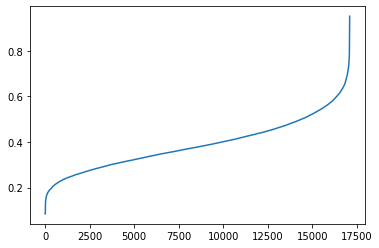

In [ ]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]

plt.plot(distances)

In [ ]:
# Numpy array of all the cluster labels assigned to each data point
db_default = DBSCAN(eps = 0.4, min_samples =70).fit(df_acp[skills_ratings_noGK])
#core_samples_mask = np.zeros_like(db_default.labels_, dtype=bool)
#core_samples_mask[db_default.core_sample_indices_] = True
labels = db_default.labels_

In [ ]:
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)

Estimated number of clusters: 4
Estimated number of noise points: 11902


In [ ]:
df_db_clusters_pca=df_acp.copy()
df_db_clusters_pca['dbscan_clusters_pca'] = db_default.labels_ #clusters
#print('Dbscan encontró: ', max(db_default.labels_), 'clusters')
df_db_clusters_pca.head(4)

,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,sofifa_id,player_url,short_name,long_name,player_positions,dob,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_joined,club_contract_valid_until,nationality_id,nationality_name,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_flag_url,position_group,overall,dbscan_clusters_pca
0,0.128905,0.236913,0.280818,0.282137,-0.091825,0.001500,0.155503,0.197141,0.083386,0.175554,0.204206,0.170031,0.199139,0.238487,0.199823,0.178309,0.137536,0.080863,0.146499,0.284927,0.170962,0.169366,0.020800,0.043714,0.024950,0.193153,-0.053842,-0.025336,0.172176,0.237982,0.136257,0.247859,-0.104278,-0.048659,-0.083580,-0.046884,-0.024424,-0.005063,-0.010362,-0.037599,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",1987-06-24,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,2021-08-10,2023.0,52,Argentina,Left,4,4,5,Medium/Low,Unique,Yes,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/flags/ar.png,nan,93.0,0
1,0.085139,0.268412,0.204815,0.230958,-0.045278,0.166830,0.106542,0.223352,0.198211,0.161753,0.236437,0.140105,0.156542,0.223203,0.101034,0.158949,0.073018,0.085620,0.081473,0.312892,0.112282,0.219081,0.149354,0.071751,0.148690,0.186485,0.134561,0.010342,0.204211,0.177631,0.239697,0.221800,-0.051532,-0.025554,-0.116302,-0.007196,-0.054294,-0.021975,-0.043276,-0.032570,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,1988-08-21,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,2014-07-01,2023.0,37,Poland,Right,4,4,5,High/Medium,Unique,Yes,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/flags/pl.png,Forward,92.0,0
2,0.154112,0.265849,0.202025,0.236352,-0.098093,0.093191,0.175496,0.210597,0.186892,0.123332,0.208562,0.145613,0.156907,0.205533,0.134664,0.149872,0.113462,0.131599,0.128042,0.304375,0.058632,0.232214,0.210593,0.072893,0.080086,0.201979,0.037172,-0.072062,0.192549,0.136509,0.215282,0.257821,-0.094647,-0.063931,-0.089285,-0.045273,-0.026091,-0.005408,-0.011069,-0.025983,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",1985-02-05,11.0,Manchester United,English Premier League,1.0,ST,7.0,2021-08-27,2023.0,38,Portugal,Right,4,5,5,High/Low,Unique,Yes,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/flags/pt.png,nan,91.0,0
3,0.191244,0.200159,0.261358,0.298850,-0.083354,-0.01710

In [ ]:
dbscan_clusters = go.Scatter(x=X_projected[:,0], y=X_projected[:,1],
                           mode='markers',
                        text=df_db_clusters_pca.loc[:,'position_group'],
                           marker=dict(
                                size=5,
                                color = labels.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

#crack =go.Scatter(x=df_db_clusters_noGK.loc[bool_crack,skill_1], y=df_db_clusters_noGK.loc[bool_crack,skill_2],name='Ckacks!!',
#                      text=df_db_clusters_noGK.loc[bool_crack,'short_name'],
#                      textfont=dict(family='sans serif',size=10,color='black'),
#                      opacity=0.9,mode='text')

data=[dbscan_clusters]#,crack]

layout = go.Layout(title="Clustering DBSCAN ",titlefont=dict(size=20),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=1000,height=650)

fig = go.Figure(data=data, layout=layout)

In [ ]:
#En Colab:
fig.show(renderer="colab")

Tal como se puede observar, el algoritmo de DBSCAN logra encontrar 4 clusters (los puntos de color rojo son ruido). En estre gráfico sumamos tmabióen el dato de la posición para poder visualizarlo, pero nuevamente observamos que no necesariamente los grupos o clusters que se encuentran están conformados por jugadores de la misma posición, sino que es bastante variado. En conclusión, la posición por si sola, aún aplicando PCA y analizando los componentes principales, no consitutye en si misma una variable "fuerte" como para influir en la conformación de los clusters.